# Stopping Customers from Leaving
John is a little worrried that his team isn't doing his best to retain customers. Rather than just randomly deploying loyalty programs and techniques, he approaches you to see if there's a better way to predict which customers aren't happy. 

# 1. Import Data

In [1]:
%pip install ydata-profiling pandas ipywidgets

  Obtaining dependency information for ydata-profiling from https://files.pythonhosted.org/packages/5b/9e/18ace1bd7616642d4a933f2957908b5c6aeb612d1dd0d13c774c8667943f/ydata_profiling-4.10.0-py2.py3-none-any.whl.metadata
  Using cached ydata_profiling-4.10.0-py2.py3-none-any.whl.metadata (20 kB)
  Obtaining dependency information for pandas from https://files.pythonhosted.org/packages/ab/63/966db1321a0ad55df1d1fe51505d2cdae191b84c907974873817b0a6e849/pandas-2.2.2-cp311-cp311-win_amd64.whl.metadata
  Using cached pandas-2.2.2-cp311-cp311-win_amd64.whl.metadata (19 kB)
  Obtaining dependency information for ipywidgets from https://files.pythonhosted.org/packages/22/2d/9c0b76f2f9cc0ebede1b9371b6f317243028ed60b90705863d493bae622e/ipywidgets-8.1.5-py3-none-any.whl.metadata
  Using cached ipywidgets-8.1.5-py3-none-any.whl.metadata (2.3 kB)
  Obtaining dependency information for scipy<1.14,>=1.4.1 from https://files.pythonhosted.org/packages/4a/48/4513a1a5623a23e95f94abd675ed91cfb19989c58e9f6f


[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import pandas as pd 
df=pd.read_csv('classificationdata.csv',index_col="id")
df.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
0,HI,156,14.0,Yes,1.0,6.0,area_code_510,no,no,0,...,108,19.138302,208.349932,130,9.190181,8.015688,7,2.248902,7,no
1,MI,216,8.0,No,14.0,9.0,area_code_408,no,no,3,...,71,15.474436,228.902063,85,10.277852,9.683971,8,2.609739,3,no
2,NH,18,20.0,No,12.0,1.0,area_code_408,no,no,1,...,55,22.547297,202.353527,127,8.898488,14.039450,8,3.845776,2,no
3,MN,174,9.0,No,12.0,6.0,area_code_415,no,no,2,...,105,16.666506,214.487530,105,9.740333,13.031063,4,3.525823,1,no
4,TX,68,19.0,No,22.0,5.0,area_code_415,no,no,1,...,88,20.408969,190.047534,113,8.813303,6.760950,4,1.828652,0,no


# 2. Split Data to Prevent Snooping Bias

In [4]:
%pip install scikit-learn

  Obtaining dependency information for scikit-learn from https://files.pythonhosted.org/packages/17/1c/ccdd103cfcc9435a18819856fbbe0c20b8fa60bfc3343580de4be13f0668/scikit_learn-1.5.2-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for threadpoolctl>=3.1.0 from https://files.pythonhosted.org/packages/4b/2c/ffbf7a134b9ab11a67b0cf0726453cedd9c5043a4fe7a35d1cefa9a1bcfb/threadpoolctl-3.5.0-py3-none-any.whl.metadata
  Using cached threadpoolctl-3.5.0-py3-none-any.whl.metadata (13 kB)
   ---------------------------------------- 0.0/11.0 MB ? eta -:--:--
   ---------------------------------------- 0.0/11.0 MB ? eta -:--:--
   ---------------------------------------- 0.0/11.0 MB ? eta -:--:--
   ---------------------------------------- 0.0/11.0 MB ? eta -:--:--
   ---------------------------------------- 0.0/11.0 MB ? eta -:--:--
   ---------------------------------------- 0.0/11.0 MB ? eta -:--:--
   ---------------------------------------- 0.0/11.0 MB ? eta -:--:--
   --


[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [5]:
from sklearn.model_selection import train_test_split

In [6]:
train,test=train_test_split(df,test_size=0.3,random_state=1234)

In [7]:
train

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,139,18.927987,217.002619,70,9.332900,8.308312,9,2.208759,2,no
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,124,16.126664,224.264014,89,10.263007,8.238645,2,2.168779,1,yes
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,109,20.911572,123.234534,87,5.731597,11.084169,5,3.153671,0,no
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,91,17.844030,215.835004,91,9.407576,19.981388,4,5.242569,0,no
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,103,12.536175,246.694873,130,10.800377,11.670808,9,3.205746,2,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8222,MS,145,10.0,No,5.0,6.0,area_code_510,no,no,1,...,87,16.510144,177.148800,88,7.970189,10.761491,5,2.836673,1,no
9449,AL,30,NaN,NaN,NaN,NaN,area_code_510,no,no,0,...,88,16.329474,155.550342,55,6.548421,6.774797,2,1.885143,0,NaN
8471,OH,165,15.0,No,16.0,10.0,area_code_510,no,no,2,...,127,18.274905,198.142324,125,9.672272,8.795677,9,2.190617,1,no


# 3. Exploratory Data Analysis

In [10]:
from matplotlib import pyplot as plt

In [11]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 12070 entries, 16692 to 1318
Data columns (total 24 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   state_code                     12070 non-null  object 
 1   tenure                         12070 non-null  int64  
 2   contract_length                12041 non-null  float64
 3   promotions_offered             12041 non-null  object 
 4   remaining_term                 12041 non-null  float64
 5   last_nps_rating                12041 non-null  float64
 6   area_code                      12063 non-null  object 
 7   international_plan             12070 non-null  object 
 8   voice_mail_plan                12050 non-null  object 
 9   number_vmail_messages          12070 non-null  int64  
 10  total_day_minutes              12070 non-null  float64
 11  total_day_calls                12070 non-null  int64  
 12  total_day_charge               12070 non-null  f

In [12]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered               29
remaining_term                   29
last_nps_rating                  29
area_code                         7
international_plan                0
voice_mail_plan                  20
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                12
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
dtype: int64

In [13]:
train.describe()

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
count,12070.000000,12041.000000,12041.000000,12041.000000,12070.000000,12070.000000,12070.000000,12070.000000,12058.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000
mean,100.310771,15.924840,11.137115,6.102815,8.638608,179.821368,100.064374,30.574659,200.288303,100.416984,17.014347,199.546252,99.791881,8.979010,10.300118,4.961806,2.774743,1.555344
std,39.742023,4.904918,7.212212,2.723722,13.030305,54.694309,20.137844,9.301168,50.899001,19.898596,4.319807,50.871813,20.195931,2.285268,2.804826,2.508605,0.750105,1.317849
min,1.000000,8.000000,1.000000,1.000000,0.000000,1.383902,1.000000,0.119603,7.605489,1.000000,1.052621,4.247707,1.000000,0.472320,0.032252,0.000000,0.013478,0.000000
25%,73.000000,12.000000,5.000000,4.000000,1.000000,142.621175,87.000000,24.323777,166.719227,87.000000,14.152096,165.683627,86.000000,7.446210,8.529475,3.000000,2.299756,1.000000
50%,100.000000,16.000000,10.000000,7.000000,2.000000,179.705079,100.000000,30.517433,200.746807,101.000000,17.049083,198.635687,99.000000,8.952996,10.382980,5.000000,2.812103,1.000000
75%,127.000000,20.000000,17.000000,8.000000,16.000000,217.024361,113.000000,36.834662,233.943152,114.000000,19.870764,234.236992,114.000000,10.520554,12.066125,6.000000,3.256842,2.000000
max,238.000000,24.000000,24.000000,10.000000,52.000000,351.091823,165.000000,59.727092,357.739429,169.000000,30.474658,394.851052,173.000000,17.700351,19.981388,20.000000,5.398333,9.000000


In [14]:
train.describe(include='object')

,state_code,promotions_offered,area_code,international_plan,voice_mail_plan,churn
count,12070,12041,12063,12070,12050,12041
unique,51,3,3,2,2,2
top,WV,No,area_code_415,no,no,no
freq,398,10957,6049,10957,8887,10314


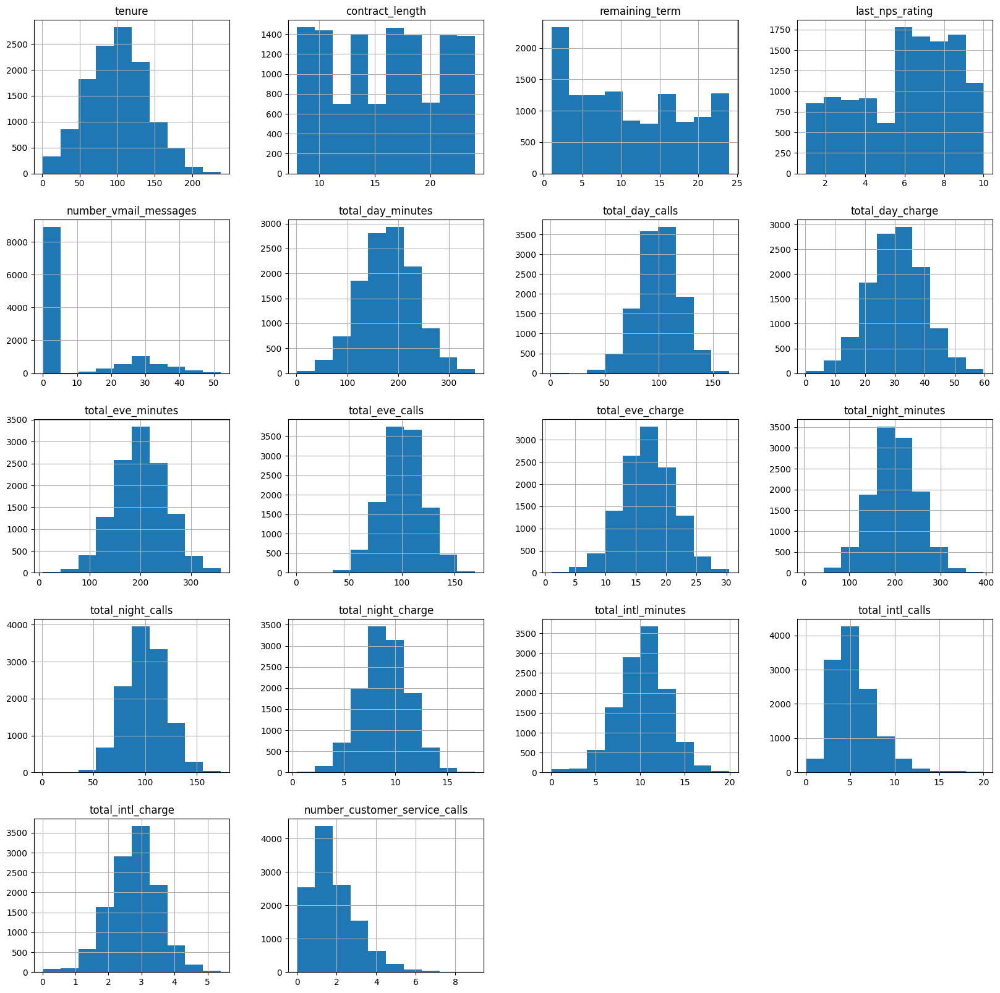

In [15]:
%matplotlib inline 
train.hist(figsize=(20,20))
plt.show()

## Birds Eye View

## Faster EDA with Pandas Profiling

In [17]:
from ydata_profiling import ProfileReport

In [18]:
profile = ProfileReport(train, title='Pandas Profiling Report')

In [19]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Analyse Categorical Features

### Inspect Target Features

In [20]:
from matplotlib import pyplot as plt
import seaborn as sns 

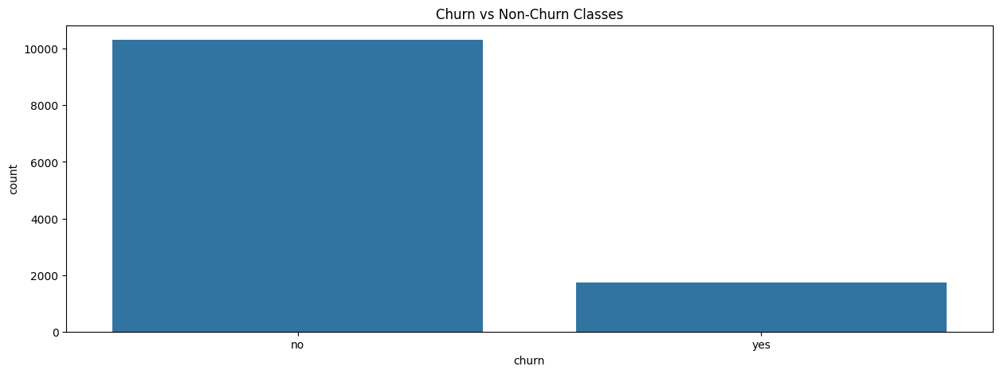

In [21]:
plt.figure(figsize=(15,5))
sns.countplot(x='churn', data=train).set_title('Churn vs Non-Churn Classes')
plt.show()

### Inspect State, Area Code and Promotions Offered

In [22]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

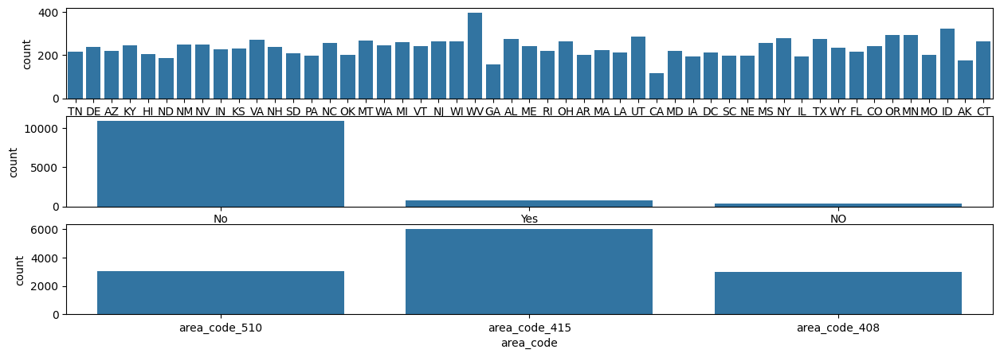

In [23]:
fig, axs = plt.subplots(3, figsize=(15,5))
sns.countplot(data=train, x='state_code', ax=axs[0])
sns.countplot(data=train, x='promotions_offered', ax=axs[1])
sns.countplot(data=train, x='area_code', ax=axs[2])
plt.show()

## Analyse Numeric Features

### Inspect Vmail messages and Customer Service Calls

In [24]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

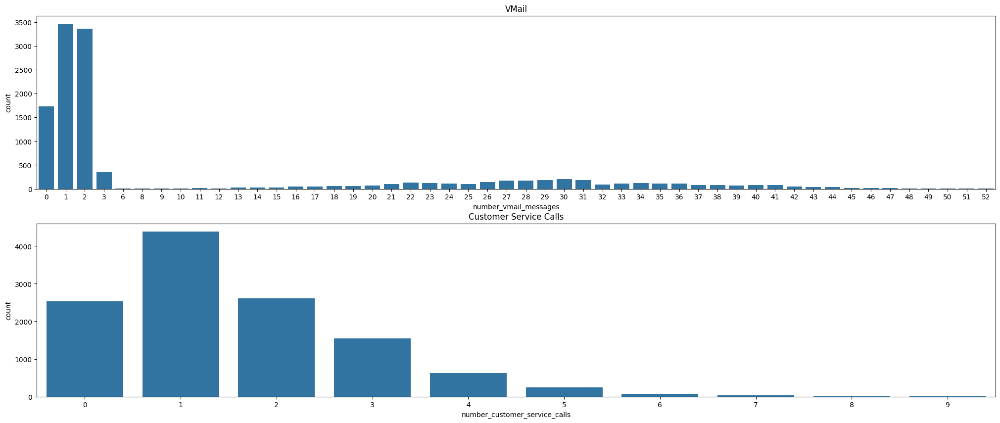

In [27]:
fig, axs = plt.subplots(2, figsize=(25,10))
sns.countplot(x='number_vmail_messages', data=train, ax=axs[0]).set_title('VMail')
sns.countplot(x='number_customer_service_calls', data=train, ax=axs[1]).set_title('Customer Service Calls')
plt.show()

### Analyse Customer Service Calls given it's Skewed

In [28]:
import numpy as np
train['number_customer_service_calls'].skew()

np.float64(1.086776733503893)

In [29]:
train['log_customer_service_calls'] = np.log(train['number_customer_service_calls']+1) 

In [30]:
train['log_customer_service_calls'].skew()

np.float64(-0.11828354478767099)

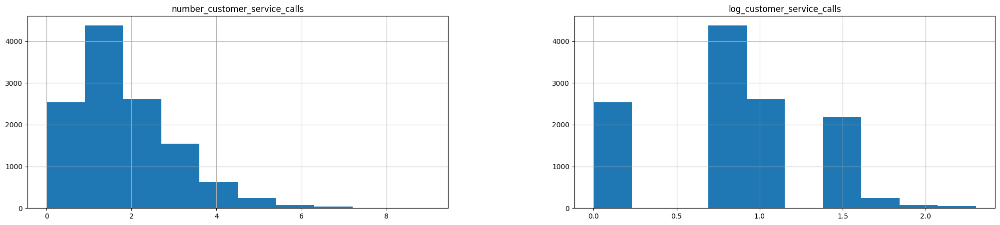

In [31]:
train[['number_customer_service_calls','log_customer_service_calls']].hist(figsize=(25,5))
plt.show()

In [32]:
train = train.drop('log_customer_service_calls', axis=1)

In [33]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

## Analyse Relationships

### Look into Numeric/Numeric Correlation

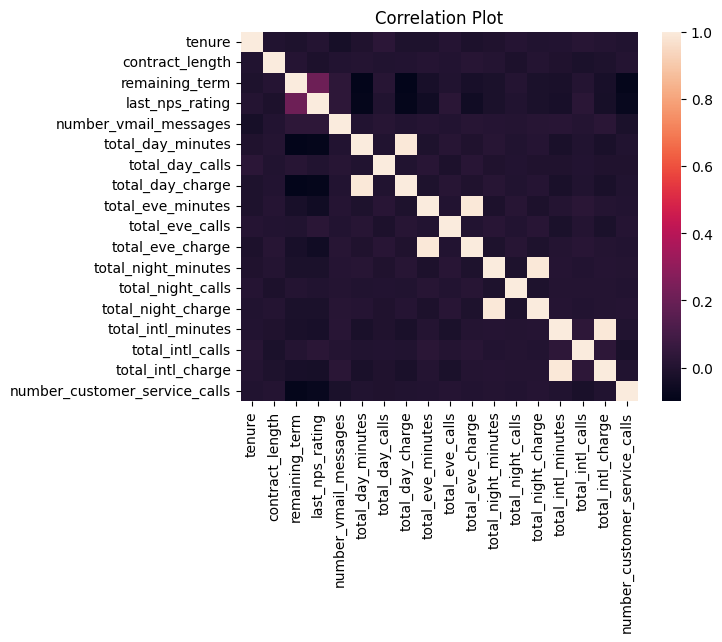

In [34]:
sns.heatmap(train.select_dtypes(exclude='object').corr()).set_title('Correlation Plot')
plt.show()

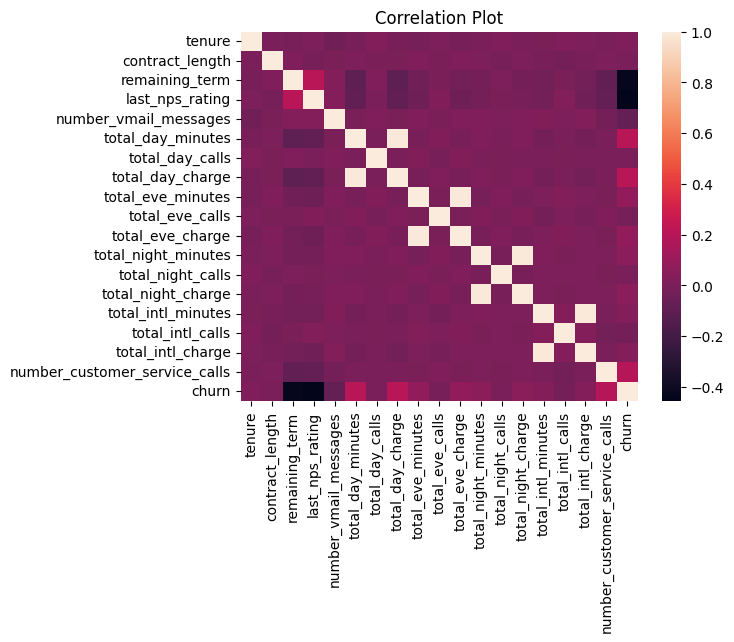

In [35]:
temp = train.copy()
temp['churn'] = temp['churn'].apply(lambda x: 1 if x=='yes' else 0) 
sns.heatmap(temp.select_dtypes(exclude='object').corr()).set_title('Correlation Plot')
plt.show()

### Plot Churn Distributions

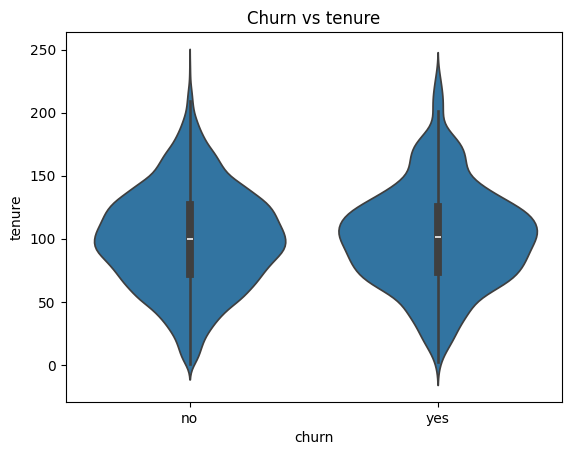

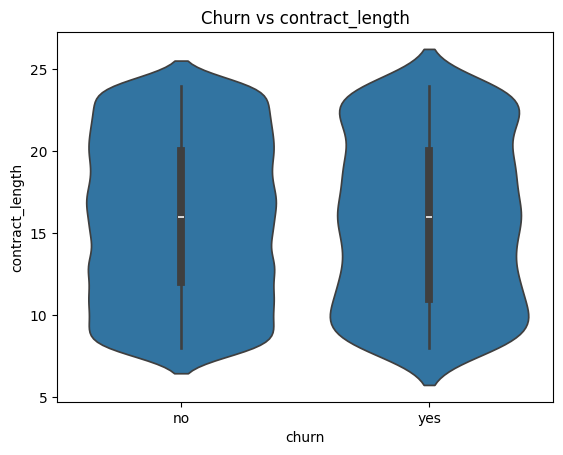

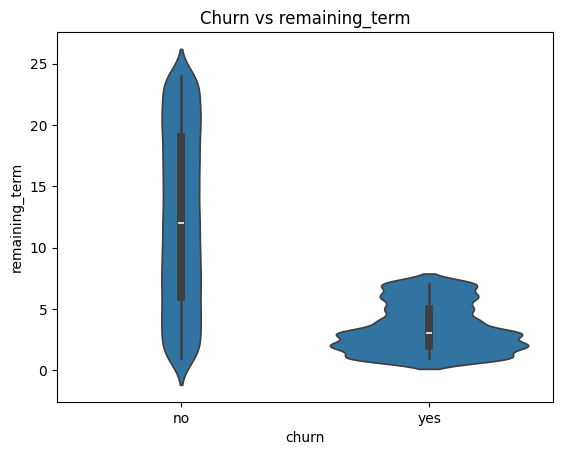

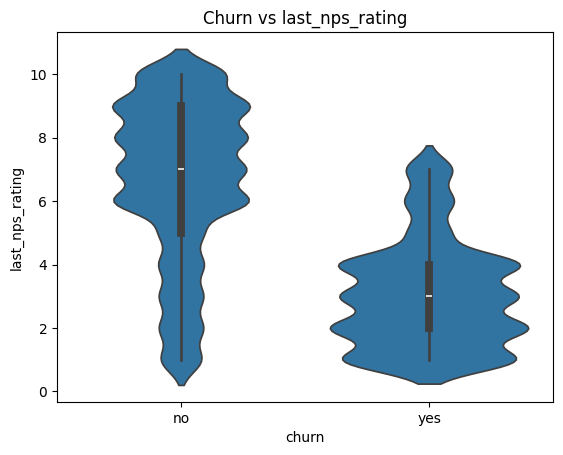

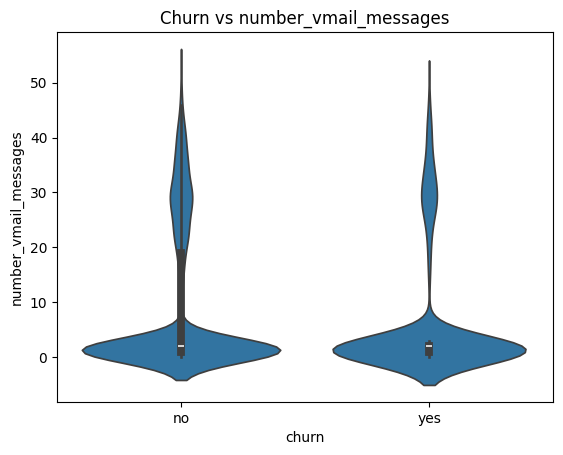

...

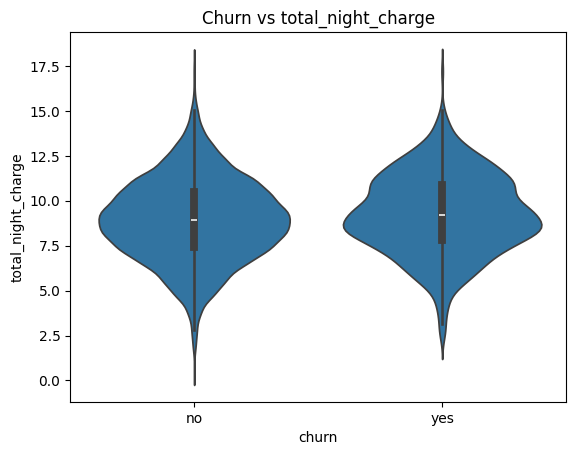

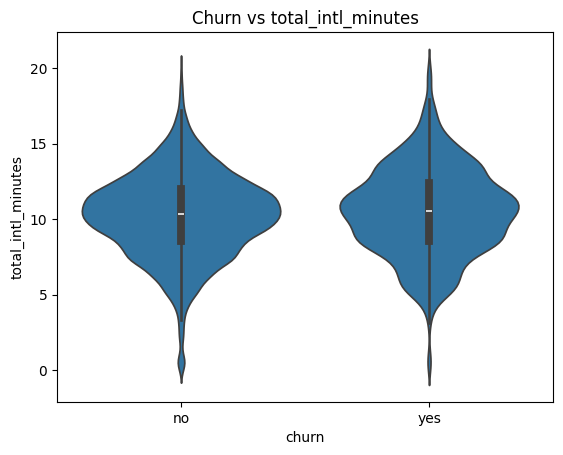

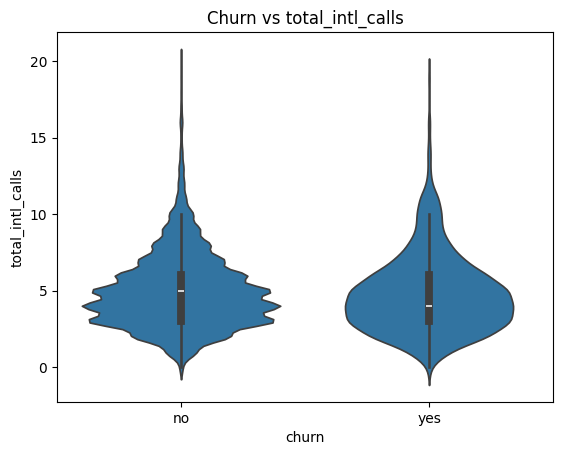

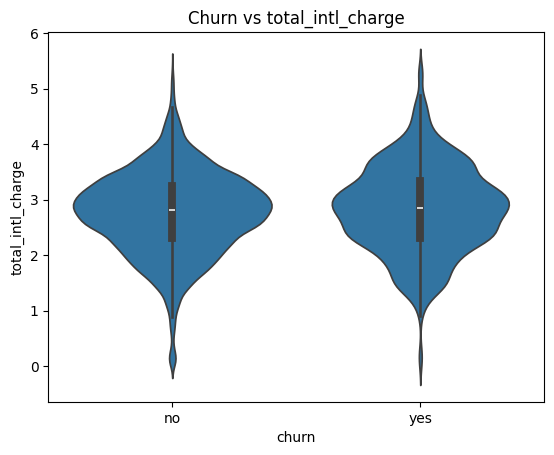

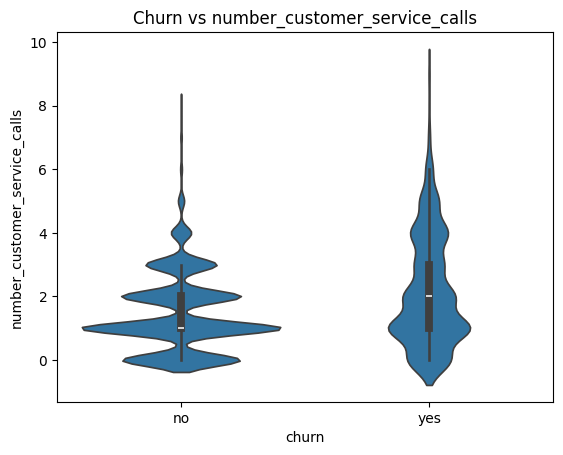

In [36]:
for col in train.select_dtypes(exclude='object').columns: 
    sns.violinplot(x='churn', y=col, data=train).set_title(f'Churn vs {col}')
    plt.show()

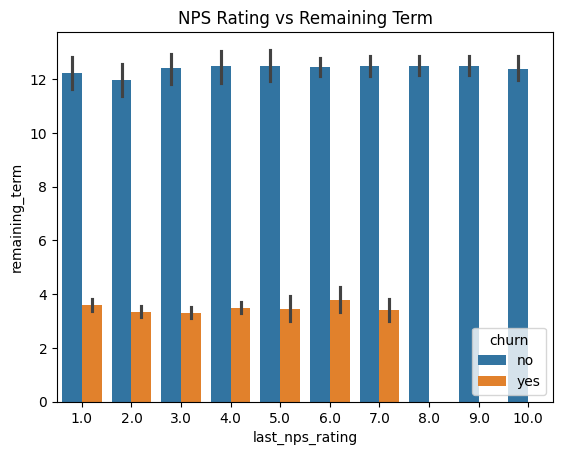

In [37]:
plt.title('NPS Rating vs Remaining Term')
sns.barplot(x='last_nps_rating', y='remaining_term', hue='churn', data=train)
plt.show()

### What about Categorical Relationships to Churn

In [38]:
train.promotions_offered.unique()

array(['No', 'Yes', 'NO', nan], dtype=object)

In [40]:
train['promotions_offered'] = train['promotions_offered'].replace(['NO', np.nan], 'No')

In [41]:
pivot_feature = 'promotions_offered' 
pd.crosstab(train[pivot_feature], train['churn']) / len(train)

churn,no,yes
promotions_offered,,
No,0.822038,0.115659
Yes,0.032477,0.027423


In [42]:
for col in train.select_dtypes(include='object').columns: 
    if col != 'churn': 
        display(pd.crosstab(train[col], train['churn']) / len(train))

churn,no,yes
state_code,,
AK,0.013670,0.000829
AL,0.019553,0.002900
AR,0.014167,0.002403
AZ,0.016321,0.001657
CA,0.007539,0.002237
CO,0.017647,0.002237
CT,0.018558,0.003231
DC,0.014250,0.003065
DE,0.016239,0.003480


churn,no,yes
promotions_offered,,
No,0.822038,0.115659
Yes,0.032477,0.027423


churn,no,yes
area_code,,
area_code_408,0.210025,0.036205
area_code_415,0.430655,0.069097
area_code_510,0.213256,0.037780


churn,no,yes
international_plan,,
no,0.796935,0.108451
yes,0.057581,0.034631


churn,no,yes
voice_mail_plan,,
no,0.616321,0.118973
yes,0.237117,0.023529


### Is there a relationship between Remaining term and NPS Rating? And...promotions offered?
Namely when Remaining term < 5 and Last nps rating < 7

In [43]:
train['nps_less_7'] = (train['last_nps_rating'] <= 7).astype(int)
train['remaining_term_less_5'] = (train['remaining_term'] < 5).astype(int)
train['churn_yes'] = train['churn'].apply(lambda x: 1 if x=='yes' else 0)
train['churn_no'] = train['churn'].apply(lambda x: 0 if x=='yes' else 1)

In [44]:
train.groupby(['nps_less_7','remaining_term_less_5']).sum(['churn_yes', 'churn_no'])[['churn_yes','churn_no']] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5                     
0          0                       0.000000  0.305220
           1                       0.000000  0.061392
1          0                       0.043331  0.405468
           1                       0.099751  0.084838

In [45]:
train['remaining_term']

id
16692    23.0
6970      7.0
9747     18.0
16099    12.0
8833     23.0
         ... 
8222      5.0
9449      NaN
8471     16.0
17048     3.0
1318     10.0
Name: remaining_term, Length: 12070, dtype: float64

In [46]:
train.groupby(['nps_less_7','remaining_term_less_5', 'promotions_offered']).sum(['churn_yes', 'churn_no'])[['churn_yes','churn_no']] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5 promotions_offered                     
0          0                     No                   0.000000  0.305220
           1                     No                   0.000000  0.061392
1          0                     No                   0.035543  0.405468
                                 Yes                  0.007788  0.000000
           1                     No                   0.080116  0.052361
                                 Yes                  0.019635  0.032477

In [47]:
train.drop(['nps_less_7', 'remaining_term_less_5','churn_yes','churn_no'], axis=1, inplace=True)

In [48]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

# 4. Data Preprocessing

## Double check we're operating with a clean slate

In [50]:
[col in df.columns for col in train.columns]

[True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True]

## Missing Area Code Data - Categorical

In [52]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         7
international_plan                0
voice_mail_plan                  20
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                12
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
dtype: int64

In [56]:
train[train['area_code'].isnull()].head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
17168,WY,54,18.0,No,19.0,7.0,NaN,no,NaN,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
4558,WY,58,22.0,No,20.0,6.0,NaN,no,NaN,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
13336,RI,79,13.0,No,9.0,6.0,NaN,no,no,2,...,68,14.943610,162.052384,106,7.171747,13.576263,6,3.658442,1,no
5772,MO,155,12.0,No,3.0,9.0,NaN,yes,no,0,...,98,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no
1642,MO,154,15.0,No,2.0,7.0,NaN,yes,no,1,...,100,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no


In [57]:
train['area_code'] = train['area_code'].fillna('missing')
train[train['area_code']=='missing']

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
17168,WY,54,18.0,No,19.0,7.0,missing,no,NaN,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
4558,WY,58,22.0,No,20.0,6.0,missing,no,NaN,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
13336,RI,79,13.0,No,9.0,6.0,missing,no,no,2,...,68,14.943610,162.052384,106,7.171747,13.576263,6,3.658442,1,no
5772,MO,155,12.0,No,3.0,9.0,missing,yes,no,0,...,98,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no
1642,MO,154,15.0,No,2.0,7.0,missing,yes,no,1,...,100,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no
16450,FL,147,16.0,No,9.0,8.0,missing,yes,no,1,...,93,20.838636,187.249514,66,8.307897,8.289207,5,2.255682,2,no
12972,MO,153,24.0,No,13.0,6.0,missing,yes,no,0,...,98,8.515226,207.015705,92,9.090795,7.466579,6,2.008288,0,no


In [58]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         0
international_plan                0
voice_mail_plan                  20
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                12
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
dtype: int64

## Missing Voice Mail Plan - Categorical

In [59]:
train['voice_mail_plan'] = train['voice_mail_plan'].fillna('missing')
train[train['voice_mail_plan']=='missing']

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
16429,HI,44,21.0,No,20.0,10.0,area_code_510,no,missing,1,...,102,18.016167,187.208784,90,8.690546,11.481874,2,3.017702,1,no
10372,HI,42,8.0,No,7.0,6.0,area_code_510,no,missing,2,...,106,17.749234,185.584080,92,8.224325,11.041335,2,3.105547,1,no
11974,MO,15,14.0,No,17.0,9.0,area_code_510,no,missing,1,...,69,11.871465,145.341081,102,7.051341,8.259750,9,2.296696,1,no
3365,MO,18,22.0,No,12.0,2.0,area_code_415,no,missing,2,...,77,22.896967,178.095650,103,8.785522,6.028258,6,1.874301,0,no
17168,WY,54,18.0,No,19.0,7.0,missing,no,missing,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
7767,AZ,4,9.0,No,7.0,3.0,area_code_408,no,missing,0,...,119,21.481234,281.874501,91,12.695069,11.408316,4,3.225750,1,yes
16037,AZ,6,16.0,No,3.0,2.0,area_code_408,no,missing,2,...,122,22.108010,288.967333,88,13.270796,11.430051,3,3.059472,1,yes
4558,WY,58,22.0,No,20.0,6.0,missing,no,missing,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
8645,MT,60,17.0,Yes,1.0,4.0,area_code_415,no,missing,1,...,75,19.991544,180.150988,108,8.345667,9.549767,3,2.468519,1,yes


## Missing Evening Minutes - Numeric

In [60]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         0
international_plan                0
voice_mail_plan                   0
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                12
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
dtype: int64

In [61]:
train[train['total_eve_minutes'].isnull()][['total_eve_minutes','churn']]

,total_eve_minutes,churn
id,,
16142,NaN,no
17168,NaN,no
4558,NaN,no
11193,NaN,yes
15828,NaN,no
12703,NaN,yes
2729,NaN,no
11475,NaN,no
15905,NaN,no


In [62]:
mean_eve_mins = train['total_eve_minutes'].mean().round(2)
mean_eve_mins

np.float64(200.29)

In [63]:
train['total_eve_minutes_missing'] = train['total_eve_minutes'].isnull().astype(int)
train['total_eve_minutes'] = train['total_eve_minutes'].fillna(mean_eve_mins)

In [64]:
train[train['total_eve_minutes_missing']==1][['total_eve_minutes_missing','total_eve_minutes']]

,total_eve_minutes_missing,total_eve_minutes
id,,
16142,1,200.29
17168,1,200.29
4558,1,200.29
11193,1,200.29
15828,1,200.29
12703,1,200.29
2729,1,200.29
11475,1,200.29
15905,1,200.29


## Missing Target Variables

In [65]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         0
international_plan                0
voice_mail_plan                   0
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 0
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
total_eve_minutes_missing         0
dtype: int64

In [66]:
train[train['churn'].isnull()]

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,total_eve_minutes_missing
id,,,,,,,,,,,,,,,,,,,,,
16332,MD,122,NaN,No,NaN,NaN,area_code_415,no,yes,23,...,14.793215,182.636917,88,8.010870,10.056127,4,2.939355,0,NaN,0
7783,MD,120,NaN,No,NaN,NaN,area_code_415,no,yes,21,...,19.158348,196.490215,88,8.102877,6.664837,7,1.809716,0,NaN,0
5127,OK,112,NaN,No,NaN,NaN,area_code_408,no,yes,22,...,13.792718,123.245273,90,6.014336,9.973846,4,2.475189,1,NaN,0
14246,DC,153,NaN,No,NaN,NaN,area_code_415,no,yes,39,...,20.009556,108.850795,112,4.465479,16.262170,4,4.354153,2,NaN,0
1612,DE,122,NaN,No,NaN,NaN,area_code_510,no,no,3,...,23.760171,185.767515,108,8.484626,12.406104,4,3.337480,1,NaN,0
2332,MD,113,NaN,No,NaN,NaN,area_code_415,no,yes,22,...,14.263494,187.836743,117,8.010496,10.394618,6,2.959332,0,NaN,0
3544,MT,94,NaN,No,NaN,NaN,area_code_415,no,no,2,...,17.301119,151.211658,125,6.476868,13.838875,3,3.773066,0,NaN,0
5704,MI,151,NaN,No,NaN,NaN,area_code_415,no,yes,27,...,15.552741,100.479370,134,5.066794,6.697073,5,1.689119,3,NaN,0
12038,MT,91,NaN,No,NaN,NaN,area_code_415,no,no,2,...,17.876354,150.315865,128,6.388716,13.326148,3,3.637971,0,NaN,0


In [67]:
train = train[~train['churn'].isnull()]
train.isnull().sum()

state_code                       0
tenure                           0
contract_length                  0
promotions_offered               0
remaining_term                   0
last_nps_rating                  0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_minutes                0
total_day_calls                  0
total_day_charge                 0
total_eve_minutes                0
total_eve_calls                  0
total_eve_charge                 0
total_night_minutes              0
total_night_calls                0
total_night_charge               0
total_intl_minutes               0
total_intl_calls                 0
total_intl_charge                0
number_customer_service_calls    0
churn                            0
total_eve_minutes_missing        0
dtype: int64

# 5. Feature Engineering

## Ratio for Correlated Predictor Variables

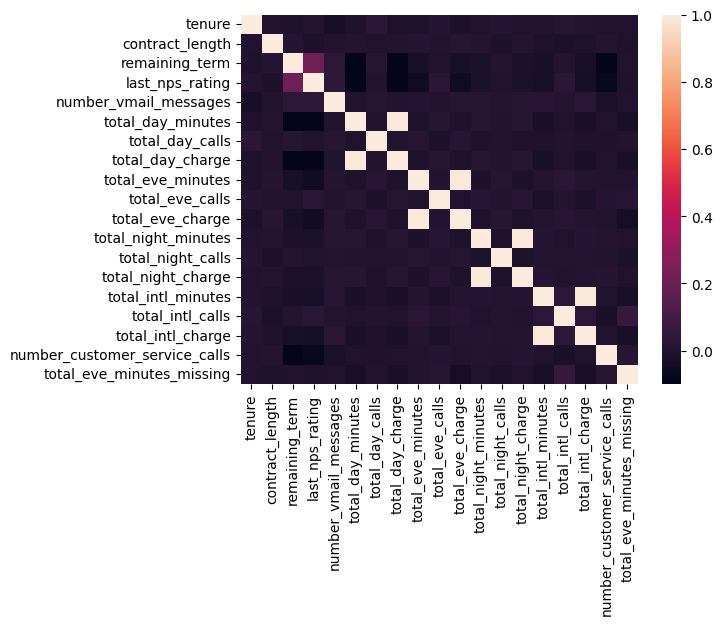

In [68]:
sns.heatmap(train.select_dtypes(exclude='object').corr())
plt.show() 

In [69]:
train['day_ratio'] = train['total_day_charge'] / train['total_day_minutes']
train['eve_ratio'] = train['total_eve_charge'] / train['total_eve_minutes']
train['night_ratio'] = train['total_night_charge'] / train['total_night_minutes']
train['intl_ratio'] = train['total_intl_charge'] / train['total_intl_minutes']

In [70]:
train.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,total_eve_minutes_missing,day_ratio,eve_ratio,night_ratio,intl_ratio
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,8.308312,9,2.208759,2,no,0,0.172815,0.083632,0.043008,0.265849
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,8.238645,2,2.168779,1,yes,0,0.169215,0.084485,0.045763,0.263245
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,11.084169,5,3.153671,0,no,0,0.158396,0.088938,0.046510,0.284520
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,19.981388,4,5.242569,0,no,0,0.178475,0.086951,0.043587,0.262373
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,11.670808,9,3.205746,2,no,0,0.168656,0.081817,0.043780,0.274681


In [71]:
train = train.drop(['total_day_charge','total_eve_charge','total_night_charge','total_intl_charge','total_day_minutes','total_eve_minutes','total_night_minutes', 'total_intl_minutes'], axis=1)

In [72]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_calls',
       'total_eve_calls', 'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'churn', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio'],
      dtype='object')

## Skewed Customer Service Calls

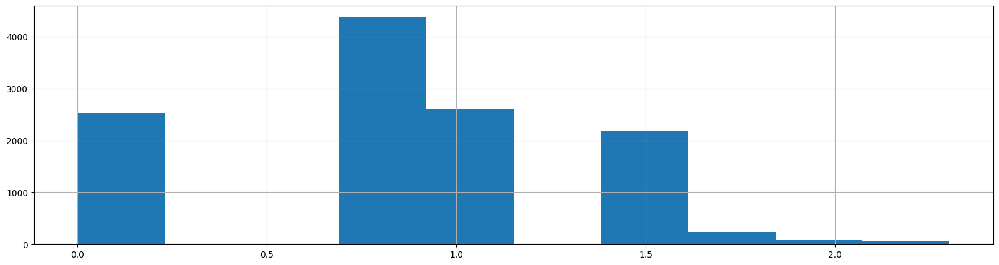

In [73]:
train['number_customer_service_calls'] = np.log(train['number_customer_service_calls']+1)
train['number_customer_service_calls'].hist(figsize=(20,5))
plt.show()

## Feature Engineering Unhappy Customers

In [75]:
train['promotions_offered'] = train['promotions_offered'].replace(['NO', np.nan], 'No')

In [76]:
train.isnull().sum()

state_code                       0
tenure                           0
contract_length                  0
promotions_offered               0
remaining_term                   0
last_nps_rating                  0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_calls                  0
total_eve_calls                  0
total_night_calls                0
total_intl_calls                 0
number_customer_service_calls    0
churn                            0
total_eve_minutes_missing        0
day_ratio                        0
eve_ratio                        0
night_ratio                      0
intl_ratio                       0
dtype: int64

In [77]:
train['unhappy_customers'] = ((train.remaining_term < 5) 
                              & (train.last_nps_rating <=7) 
                              & (train.promotions_offered == 'No')).astype(int)

In [78]:
train[train['unhappy_customers']==1].head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_night_calls,total_intl_calls,number_customer_service_calls,churn,total_eve_minutes_missing,day_ratio,eve_ratio,night_ratio,intl_ratio,unhappy_customers
id,,,,,,,,,,,,,,,,,,,,,
3584,NM,182,10.0,No,3.0,3.0,area_code_408,no,yes,30,...,118,1,1.386294,no,0,0.169449,0.087521,0.045246,0.274974,1
17212,OK,103,23.0,No,4.0,2.0,area_code_415,no,no,2,...,89,16,0.693147,yes,0,0.169476,0.084495,0.045747,0.258265,1
2321,MT,100,22.0,No,2.0,7.0,area_code_415,no,no,1,...,81,4,0.693147,no,0,0.171099,0.083300,0.044048,0.267411,1
15834,WA,58,23.0,No,2.0,3.0,area_code_408,no,no,1,...,142,8,0.000000,yes,0,0.171940,0.089352,0.047560,0.274232,1
8608,IN,67,9.0,No,2.0,4.0,area_code_510,no,no,2,...,99,6,1.098612,yes,0,0.175524,0.084723,0.043051,0.246410,1


## Create Target and Feature Variables

In [79]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_calls                    int64
total_eve_calls                    int64
total_night_calls                  int64
total_intl_calls                   int64
number_customer_service_calls    float64
churn                             object
total_eve_minutes_missing          int64
day_ratio                        float64
eve_ratio                        float64
night_ratio                      float64
intl_ratio                       float64
unhappy_customers                  int64
dtype: object

In [80]:
from sklearn.preprocessing import OneHotEncoder

In [81]:
X_train = train.drop('churn', axis=1)
y_train = np.where(train['churn']=='yes', 1, 0)

In [82]:
X_train

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_night_calls,total_intl_calls,number_customer_service_calls,total_eve_minutes_missing,day_ratio,eve_ratio,night_ratio,intl_ratio,unhappy_customers
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,139,70,9,1.098612,0,0.172815,0.083632,0.043008,0.265849,0
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,124,89,2,0.693147,0,0.169215,0.084485,0.045763,0.263245,0
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,109,87,5,0.000000,0,0.158396,0.088938,0.046510,0.284520,0
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,91,91,4,0.000000,0,0.178475,0.086951,0.043587,0.262373,0
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,103,130,9,1.098612,0,0.168656,0.081817,0.043780,0.274681,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1182,MO,108,15.0,No,6.0,2.0,area_code_415,no,yes,41,...,103,117,5,1.098612,0,0.137959,0.090143,0.044879,0.283492,0
8222,MS,145,10.0,No,5.0,6.0,area_code_510,no,no,1,...,87,88,5,0.693147,0,0.179808,0.084525,0.044991,0.263595,0
8471,OH,165,15.0,No,16.0,10.0,area_code_510,no,no,2,...,127,125,9,0.693147,0,0.166420,0.091960,0.048815,0.249056,0


In [83]:
onehot = OneHotEncoder(handle_unknown='ignore')
encoded_columns = onehot.fit_transform(X_train.select_dtypes(include='object')).toarray()

In [84]:
onehot.get_feature_names_out()

array(['state_code_AK', 'state_code_AL', 'state_code_AR', 'state_code_AZ',
       'state_code_CA', 'state_code_CO', 'state_code_CT', 'state_code_DC',
       'state_code_DE', 'state_code_FL', 'state_code_GA', 'state_code_HI',
       'state_code_IA', 'state_code_ID', 'state_code_IL', 'state_code_IN',
       'state_code_KS', 'state_code_KY', 'state_code_LA', 'state_code_MA',
       'state_code_MD', 'state_code_ME', 'state_code_MI', 'state_code_MN',
       'state_code_MO', 'state_code_MS', 'state_code_MT', 'state_code_NC',
       'state_code_ND', 'state_code_NE', 'state_code_NH', 'state_code_NJ',
       'state_code_NM', 'state_code_NV', 'state_code_NY', 'state_code_OH',
       'state_code_OK', 'state_code_OR', 'state_code_PA', 'state_code_RI',
       'state_code_SC', 'state_code_SD', 'state_code_TN', 'state_code_TX',
       'state_code_UT', 'state_code_VA', 'state_code_VT', 'state_code_WA',
       'state_code_WI', 'state_code_WV', 'state_code_WY',
       'promotions_offered_No', 'promotion

In [85]:
X_train = X_train.select_dtypes(exclude='object')
X_train[onehot.get_feature_names_out()] = encoded_columns

In [86]:
X_train.head()

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_calls,total_eve_calls,total_night_calls,total_intl_calls,number_customer_service_calls,...,promotions_offered_Yes,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,area_code_missing,international_plan_no,international_plan_yes,voice_mail_plan_missing,voice_mail_plan_no,voice_mail_plan_yes
id,,,,,,,,,,,,,,,,,,,,,
16692,100,18.0,23.0,9.0,2,80,139,70,9,1.098612,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
6970,92,15.0,7.0,7.0,0,106,124,89,2,0.693147,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
9747,62,10.0,18.0,10.0,20,127,109,87,5,0.000000,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
16099,143,12.0,12.0,6.0,1,120,91,91,4,0.000000,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
8833,123,19.0,23.0,7.0,0,105,103,130,9,1.098612,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0


## Dealing with Imbalanced Classes

In [87]:
!pip install imblearn

  Obtaining dependency information for imblearn from https://files.pythonhosted.org/packages/81/a7/4179e6ebfd654bd0eac0b9c06125b8b4c96a9d0a8ff9e9507eb2a26d2d7e/imblearn-0.0-py2.py3-none-any.whl.metadata
  Obtaining dependency information for imbalanced-learn from https://files.pythonhosted.org/packages/5a/fa/267de06c95210580f4b82b45cec1ce1e9ce1f21a01a684367db89e7da70d/imbalanced_learn-0.12.3-py3-none-any.whl.metadata
   ---------------------------------------- 0.0/258.3 kB ? eta -:--:--
   - -------------------------------------- 10.2/258.3 kB ? eta -:--:--
   ------ -------------------------------- 41.0/258.3 kB 991.0 kB/s eta 0:00:01
   ------ -------------------------------- 41.0/258.3 kB 991.0 kB/s eta 0:00:01
   ------ -------------------------------- 41.0/258.3 kB 991.0 kB/s eta 0:00:01
   --------- ----------------------------- 61.4/258.3 kB 273.8 kB/s eta 0:00:01
   ------------ -------------------------- 81.9/258.3 kB 327.3 kB/s eta 0:00:01
   ------------ --------------------


[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [88]:
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE, RandomOverSampler

In [89]:
sm = SMOTE(random_state=1234)
X_train, y_train = sm.fit_resample(X_train, y_train)

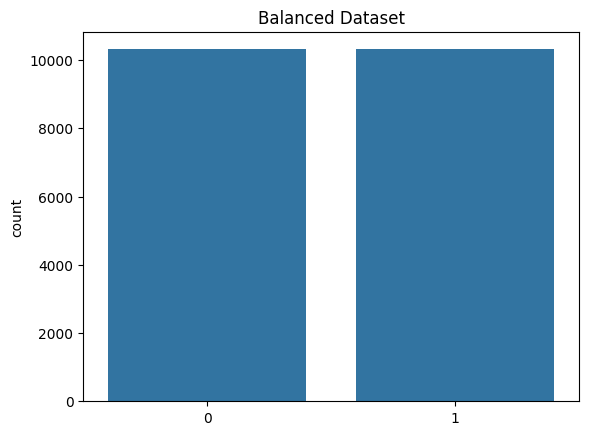

In [90]:
sns.countplot(x=y_train).set_title('Balanced Dataset')
plt.show()

# 6. Modelling

## Build Pipelines

In [91]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [93]:
%pip install xgboost

  Obtaining dependency information for xgboost from https://files.pythonhosted.org/packages/e2/7b/8c1b410cd0604cee9a167a19f7e1746f5b92ae7d02ad574ab560b73c5a48/xgboost-2.1.1-py3-none-win_amd64.whl.metadata
   ---------------------------------------- 0.0/124.9 MB ? eta -:--:--
   ---------------------------------------- 0.0/124.9 MB ? eta -:--:--
   ---------------------------------------- 0.1/124.9 MB 1.8 MB/s eta 0:01:09
   ---------------------------------------- 0.3/124.9 MB 3.4 MB/s eta 0:00:37
   ---------------------------------------- 0.6/124.9 MB 3.9 MB/s eta 0:00:33
   ---------------------------------------- 0.9/124.9 MB 4.4 MB/s eta 0:00:28
   ---------------------------------------- 1.1/124.9 MB 4.6 MB/s eta 0:00:28
   ---------------------------------------- 1.3/124.9 MB 4.5 MB/s eta 0:00:28
   ---------------------------------------- 1.4/124.9 MB 4.2 MB/s eta 0:00:30
    --------------------------------------- 1.6/124.9 MB 4.0 MB/s eta 0:00:31
    -------------------------


[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip



   -------------------------- ------------ 85.6/124.9 MB 679.9 kB/s eta 0:00:58
   -------------------------- ------------ 85.7/124.9 MB 682.7 kB/s eta 0:00:58
   -------------------------- ------------ 85.8/124.9 MB 685.5 kB/s eta 0:00:58
   -------------------------- ------------ 85.8/124.9 MB 686.3 kB/s eta 0:00:57
   -------------------------- ------------ 85.9/124.9 MB 694.3 kB/s eta 0:00:57
   -------------------------- ------------ 85.9/124.9 MB 694.3 kB/s eta 0:00:57
   -------------------------- ------------ 85.9/124.9 MB 694.3 kB/s eta 0:00:57
   -------------------------- ------------ 86.0/124.9 MB 692.8 kB/s eta 0:00:57
   -------------------------- ------------ 86.0/124.9 MB 692.8 kB/s eta 0:00:57
   -------------------------- ------------ 86.0/124.9 MB 692.8 kB/s eta 0:00:57
   -------------------------- ------------ 86.0/124.9 MB 693.5 kB/s eta 0:00:57
   -------------------------- ------------ 86.0/124.9 MB 693.5 kB/s eta 0:00:57
   -------------------------- ---------

In [94]:
from sklearn.linear_model import SGDClassifier, RidgeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier

In [95]:
pipelines = {
    'sgd':make_pipeline(StandardScaler(), SGDClassifier()), 
    'ridge':make_pipeline(StandardScaler(), RidgeClassifier()), 
    'rf':make_pipeline(StandardScaler(), RandomForestClassifier()), 
    'gb':make_pipeline(StandardScaler(), GradientBoostingClassifier()), 
    'xg':make_pipeline(StandardScaler(), XGBClassifier()), 
}

## Build Grids

In [96]:
grid = {
    'sgd':{
        'sgdclassifier__alpha':[0.00001, 0.0001, 0.001, 0.01]
    },
    'ridge':{
        'ridgeclassifier__alpha':[0.01, 0.5, 1.0, 2.0, 3.0]
    },
    'rf':{
        'randomforestclassifier__n_estimators':[50,100,200,300], 
        'randomforestclassifier__max_depth':[None, 5, 7, 9]
    },
    'gb':{
        'gradientboostingclassifier__n_estimators':[50,100,200,300], 
        'gradientboostingclassifier__max_depth':[None, 3, 5, 7, 9]
    },
    'xg':{
        'xgbclassifier__n_estimators':[50,100,200,300], 
        'xgbclassifier__max_depth':[None, 3, 5, 7, 9]
    }
}

## Train Models

In [97]:
from sklearn.model_selection import GridSearchCV

In [98]:
fit_models = {}
for algo, pipeline in pipelines.items(): 
    try: 
        print(f'Commencing training for {algo}')
        model = GridSearchCV(pipeline, grid[algo], n_jobs=-1, cv=10)
        model.fit(X_train, y_train)
        fit_models[algo] = model 
        print(f'Training completed for {algo}')

    except Exception as e: 
        print(f'There was an error training the {algo} model: {e}')

Commencing training for sgd
Training completed for sgd
Commencing training for ridge
Training completed for ridge
Commencing training for rf
Training completed for rf
Commencing training for gb
Training completed for gb
Commencing training for xg
Training completed for xg


In [99]:
fit_models

{'sgd': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('sgdclassifier', SGDClassifier())]),
              n_jobs=-1,
              param_grid={'sgdclassifier__alpha': [1e-05, 0.0001, 0.001, 0.01]}),
 'ridge': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('ridgeclassifier', RidgeClassifier())]),
              n_jobs=-1,
              param_grid={'ridgeclassifier__alpha': [0.01, 0.5, 1.0, 2.0, 3.0]}),
 'rf': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('randomforestclassifier',
                                         RandomForestClassifier())]),
              n_jobs=-1,
              param_grid={'randomforestclassifier__max_depth': [None, 5, 7, 9],
                          'randomforestclassifier__n_estimators':

# 7. Evaluation

## Apply Transformations to Test Data

In [103]:
col_order = X_train.columns

In [106]:
def transform_data(test_df, col_order, mean_eve_mins, onehot): 
 
    X = test_df.copy()
    
    X['area_code'] =  X['area_code'].fillna('missing')
    X['voice_mail_plan'] = X['voice_mail_plan'].fillna('missing')
    X['total_eve_minutes_missing'] = X['total_eve_minutes'].isnull().astype(int)
    X['total_eve_minutes'] = X['total_eve_minutes'].fillna(mean_eve_mins)

    X['day_ratio'] = X['total_day_charge'] / X['total_day_minutes']
    X['eve_ratio'] = X['total_eve_charge'] / X['total_eve_minutes']
    X['night_ratio'] = X['total_night_charge'] / X['total_night_minutes']
    X['intl_ratio'] = X['total_intl_charge'] / X['total_intl_minutes']
    X = X.drop(['total_day_charge','total_eve_charge','total_night_charge','total_intl_charge','total_day_minutes','total_eve_minutes','total_night_minutes', 'total_intl_minutes'], axis=1)
    
    X['number_customer_service_calls'] = np.log(X['number_customer_service_calls']+1)
    
    X['promotions_offered'] = X['promotions_offered'].replace(['NO', np.nan], 'No')
    X['unhappy_customers'] = ((X.remaining_term < 5) 
                              & (X.last_nps_rating <=7) 
                              & (X.promotions_offered == 'No')).astype(int)
    
    encoded_columns = onehot.transform(X.select_dtypes(include='object')).toarray()
    X = X.select_dtypes(exclude='object')
    X[onehot.get_feature_names_out()] = encoded_columns
    
    return X[col_order]

In [101]:
test = test[~test['churn'].isnull()]

In [107]:
test.isnull().sum()

state_code                        0
tenure                            0
contract_length                   0
promotions_offered                0
remaining_term                    0
last_nps_rating                   0
area_code                         5
international_plan                0
voice_mail_plan                  10
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 6
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                             0
dtype: int64

In [108]:
X_test = transform_data(test.drop('churn', axis=1), col_order, mean_eve_mins, onehot)

In [109]:
X_test

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_calls,total_eve_calls,total_night_calls,total_intl_calls,number_customer_service_calls,...,promotions_offered_Yes,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,area_code_missing,international_plan_no,international_plan_yes,voice_mail_plan_missing,voice_mail_plan_no,voice_mail_plan_yes
id,,,,,,,,,,,,,,,,,,,,,
15297,75,13.0,3.0,9.0,1,121,63,97,6,1.386294,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7075,150,17.0,5.0,9.0,1,111,78,88,4,0.693147,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
3733,87,11.0,6.0,9.0,2,132,95,49,2,0.693147,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
10674,110,9.0,19.0,6.0,1,85,116,90,3,0.693147,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7360,132,23.0,2.0,1.0,0,101,90,93,8,0.693147,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1120,44,24.0,9.0,10.0,2,71,104,113,3,1.386294,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
7101,113,22.0,17.0,9.0,1,112,76,97,6,0.693147,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7062,111,22.0,24.0,9.0,16,78,121,105,8,0.693147,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [110]:
y_test = np.where(test['churn']=='yes', 1, 0)

## Evaluate Performance Metrics

In [111]:
from sklearn.metrics import accuracy_score, recall_score, precision_score, confusion_matrix

In [112]:
for algo, model in fit_models.items(): 
    yhat = model.predict(X_test)
    accuracy = accuracy_score(y_test, yhat)
    precision = precision_score(y_test, yhat)
    recall = recall_score(y_test, yhat) 
    print(f'{algo} model scores Accuracy:{accuracy}, Precision:{precision}, Recall:{recall}') 

sgd model scores Accuracy:0.8921435499515034, Precision:0.5776658270361041, Recall:0.9284750337381916
ridge model scores Accuracy:0.8622696411251213, Precision:0.5111430625449317, Recall:0.9595141700404858
rf model scores Accuracy:0.9497575169738118, Precision:0.8081841432225064, Recall:0.8529014844804319
gb model scores Accuracy:0.9511154219204656, Precision:0.8221343873517787, Recall:0.8421052631578947
xg model scores Accuracy:0.953443258971872, Precision:0.8436213991769548, Recall:0.8299595141700404


- The precision is the ratio tp / (tp + fp) where tp is the number of true positives and fp the number of false positives. The precision is intuitively the ability of the classifier not to label as positive a sample that is negative.
- The recall is the ratio tp / (tp + fn) where tp is the number of true positives and fn the number of false negatives. The recall is intuitively the ability of the classifier to find all the positive samples.

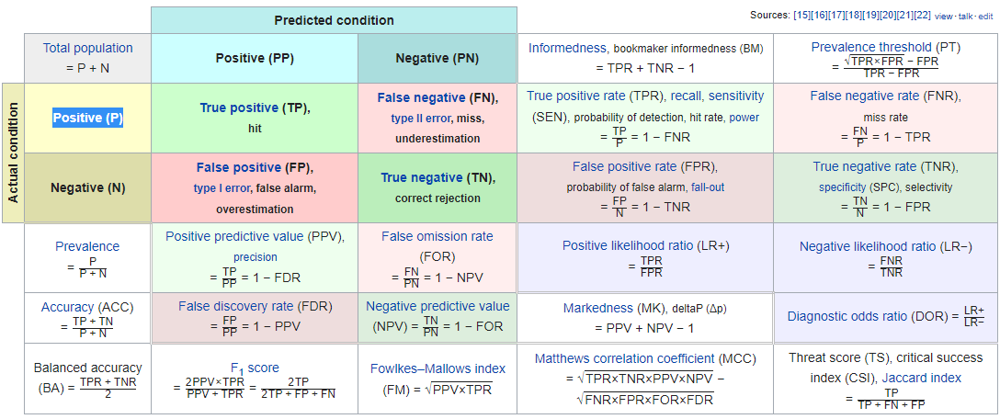

## Understanding Performance Metrics

In [113]:
model = fit_models['xg']

In [114]:
yhat = model.predict(X_test)

In [115]:
confusion_matrix(y_test, yhat, labels=[1,0])

array([[ 615,  126],
       [ 114, 4300]])

In [123]:
accuracy = (4300+615) / ( 615+4300+126+114)
accuracy

0.953443258971872

In [122]:
accuracy_sklearn = accuracy_score(y_test, yhat)
print(f"Accuracy: {accuracy_sklearn}")

Accuracy: 0.953443258971872


In [124]:
precision = 615/ (615+114)
precision

0.8436213991769548

In [125]:
recall = 615/ (615+126)
recall

0.8299595141700404

## Make a Prediction

In [126]:
yhat = model.predict(X_test)
yhat

array([0, 0, 0, ..., 0, 0, 0])

In [127]:
res = pd.DataFrame([y_test, yhat])
res = res.T
res.columns = ['ytrue','ypred']
res.head(6)

,ytrue,ypred
0,0,0
1,0,0
2,0,0
3,0,0
4,1,1
5,1,0


# 8. Deployment

## Save Models and Encoder

In [128]:
import os 
import pickle

In [129]:
SAVE_PATH = os.path.join('models', 'experiment_1')
if not os.path.exists(SAVE_PATH):
    os.makedirs(SAVE_PATH)

In [130]:
for algo, model in fit_models.items(): 
    FILE_PATH = os.path.join(SAVE_PATH, f'{algo}.pkl')
    with open(FILE_PATH, 'wb') as f: 
        pickle.dump(model, f) 

In [131]:
ENCODER_FILE_PATH = os.path.join(SAVE_PATH, 'encoder.pkl')
with open(ENCODER_FILE_PATH, 'wb') as f: 
    pickle.dump(onehot, f) 

## Create a Model Schema

In [132]:
def extract_column_values(col, df): 
    if df[col].dtype == 'O': 
        return list(df[col].unique())
    elif df[col].dtype == 'int64': 
        return (int(df[col].min()), int(df[col].max()))
    elif df[col].dtype == 'float64': 
        return (float(df[col].min()),float(df[col].max()))
    else: 
        return list(df[col].unique().astype(str))

In [133]:
column_info = {col:{'dtype':str(df[col].dtype), 'values':extract_column_values(col, df)} for col in df.columns}

In [134]:
column_info

{'state_code': {'dtype': 'object',
  'values': ['HI',
   'MI',
   'NH',
   'MN',
   'TX',
   'WY',
   'IN',
   'IL',
   'TN',
   'MA',
   'DC',
   'NV',
   'PA',
   'AK',
   'NM',
   'WI',
   'ND',
   'NJ',
   'AR',
   'NE',
   'NY',
   'OK',
   'SD',
   'KY',
   'ID',
   'VT',
   'IA',
   'MT',
   'AL',
   'MS',
   'ME',
   'WV',
   'RI',
   'VA',
   'OH',
   'SC',
   'MD',
   'CO',
   'AZ',
   'NC',
   'CT',
   'MO',
   'UT',
   'DE',
   'WA',
   'KS',
   'CA',
   'FL',
   'LA',
   'GA',
   'OR']},
 'tenure': {'dtype': 'int64', 'values': (1, 242)},
 'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
 'promotions_offered': {'dtype': 'object', 'values': ['Yes', 'No', 'NO', nan]},
 'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
 'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
 'area_code': {'dtype': 'object',
  'values': ['area_code_510', 'area_code_408', 'area_code_415', nan]},
 'international_plan': {'dtype': 'object', 'values': ['no', 'yes

In [135]:
transformed_cols = {'transformed_columns':X_train.columns.to_list()}
schema = {'column_info':column_info, 'transformed_columns':transformed_cols}

In [136]:
schema

{'column_info': {'state_code': {'dtype': 'object',
   'values': ['HI',
    'MI',
    'NH',
    'MN',
    'TX',
    'WY',
    'IN',
    'IL',
    'TN',
    'MA',
    'DC',
    'NV',
    'PA',
    'AK',
    'NM',
    'WI',
    'ND',
    'NJ',
    'AR',
    'NE',
    'NY',
    'OK',
    'SD',
    'KY',
    'ID',
    'VT',
    'IA',
    'MT',
    'AL',
    'MS',
    'ME',
    'WV',
    'RI',
    'VA',
    'OH',
    'SC',
    'MD',
    'CO',
    'AZ',
    'NC',
    'CT',
    'MO',
    'UT',
    'DE',
    'WA',
    'KS',
    'CA',
    'FL',
    'LA',
    'GA',
    'OR']},
  'tenure': {'dtype': 'int64', 'values': (1, 242)},
  'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
  'promotions_offered': {'dtype': 'object',
   'values': ['Yes', 'No', 'NO', nan]},
  'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
  'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
  'area_code': {'dtype': 'object',
   'values': ['area_code_510', 'area_code_408', 'area_code_

In [137]:
os.makedirs('app')

In [138]:
import json
with open(os.path.join('app', 'schema.json'), 'w') as f: 
    json.dump(schema, f) 

# 9. Test Scoring

## Load Models and Encoder

In [139]:
with open(os.path.join(SAVE_PATH, 'xg.pkl'), 'rb') as f:
    model = pickle.load(f)

In [140]:
with open(os.path.join(SAVE_PATH, 'encoder.pkl'), 'rb') as f:
    onehot = pickle.load(f)

In [141]:
with open(os.path.join('app', 'schema.json'), 'r') as f:
    schema = json.load(f)

## Transform Test Sample and Predict

In [142]:
res = {
  "state_code": "OH",
  "area_code": "area_code_415",
  "international_plan": "no",
  "voice_mail_plan": "yes",
  "number_vmail_messages": "26",
  "total_day_minutes": 161.6,
  "total_day_calls": 123,
  "total_day_charge": 27.47,
  "total_eve_minutes": 195.5,
  "total_eve_calls": 103,
  "total_eve_charge": 16.62,
  "total_night_minutes": 254.4,
  "total_night_calls": 103,
  "total_night_charge": 11.45,
  "total_intl_minutes": 13.7,
  "total_intl_calls": 3,
  "total_intl_charge": 3.7,
  "promotions_offered":"No", 
  "number_customer_service_calls": 5.0, 
  "tenure":4, 
  "contract_length":5,
  "remaining_term":10, 
  "last_nps_rating":10
}

In [143]:
column_order_in = list(schema['column_info'].keys())[:-1]
column_order_out = list(schema['transformed_columns']['transformed_columns'])

In [144]:
scoring_data = pd.Series(res).to_frame().T
scoring_data = scoring_data[column_order_in]

In [145]:
for column, column_properties in schema['column_info'].items(): 
    if column != 'churn': 
        dtype = column_properties['dtype']
        scoring_data[column] = scoring_data[column].astype(dtype)

In [146]:
scoring_sample = transform_data(scoring_data, column_order_out, mean_eve_mins, onehot)

In [147]:
model.predict(scoring_sample)

array([0])